# Distance matrices and evidence for clustering 

## Preamble

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import json

import sys
sys.path.append('../')
from helpers import cm2inch, title, show_num_contours, load_datasets
from melodic_contour import *
matplotlib.style.use('styles.mplstyle')

from sklearn import metrics
from sklearn.decomposition import PCA
from sklearn.manifold import MDS
from sklearn.manifold import TSNE
import tslearn
from tslearn.metrics import cdist_dtw

from scipy.spatial import distance_matrix
from unidip.dip import diptst as diptest

/Users/bas/repos/papers/contour-typology/env/lib/python3.7/site-packages/tslearn/bases/bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


## Clusterability and the dist-dip test

What would be a good typology to describe the variety of phrase contours? Ideally, the types in the topology would correspond to clusters in the (continuous) space of phrase contours. Are there any such clusters? This is sometimes known as the question of **clusterability**: is there evidence for multiple clusters in the data? Is the space **multimodal**? We deal with this before we come to the next question: how many clusters are there? What is $k$? 

A recent comparison of clusterability methods  (Adolfsson et al 2019) recommends the **dist-dip** method: the dip test on pairwise distances. This method builds on way to test whether univariate distributions are unimodal, known as the *(Hartigans') dip test* (Hartigan & Hartigan, 1985). It is named after it's central statistic: the *dip*. This is essentially the largest distance between the empirical cdf and it's closest unimodal approximation. Kalogeratos and Likas (2012) extended this to arbitrary distributions. The idea is that if a sample of points has multiple modes or clusters, there will be at least two 'types' of distances: small within-cluster distances and large between-cluster distances. Or more precisely: the distribution of pairwise distances is at least bimodal. And so by applying Hartigans' dip test to the set of pairwise distances you can test for multimodality. 

The following figure illustrates this for a bivariate distribution, which is multimodal according to Hartigan's dip test applied to the pairwise distances ($p < 0.01$).

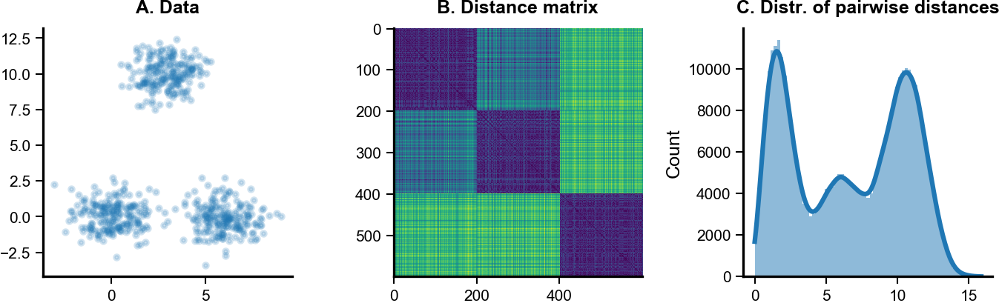

In [2]:
plt.figure(figsize=cm2inch(12, 4))
plt.subplot(131)
data = np.concatenate([
        np.random.multivariate_normal([0, 0], [[1, 0], [0, 1]], 200),
        np.random.multivariate_normal([6, 0], [[1, 0], [0, 1]], 200),
        np.random.multivariate_normal([3, 10], [[1, 0], [0, 1]], 200)
])
x, y = data.T
plt.plot(x, y, '.', alpha=.2)
plt.title('A. Data')

plt.subplot(132)
dm = distance_matrix(data, data)
plt.imshow(dm)
plt.title('B. Distance matrix')

plt.subplot(133)
sns.histplot(np.msort(dm.ravel()), kde=True, lw=0);
plt.title('C. Distr. of pairwise distances');
plt.tight_layout()

In [3]:
dip, pval, (left_idx, right_idx) = diptest(np.msort(dm.ravel()), is_hist=False, numt=100)

In [4]:
print(f'p = {pval:.5f}')

p = 0.00990


## Data filtering

We look at contours from three traditions: German (`erk`), Chinese (`han`) and Gregorian chant (`antiphons`). To account for an effect of phrase length we restrict ourselves to phrases of length 6–10.

In [8]:
dfs, all_contours = load_datasets(normalize=False, dir='../contours',
                                 dataset_ids=[
        'erk',
        'boehme',
        'creighton',
        'han', 
        'natmin',
        'shanxi',
        'liber-antiphons',
        'liber-responsories',
        'liber-alleluias'
    ], )

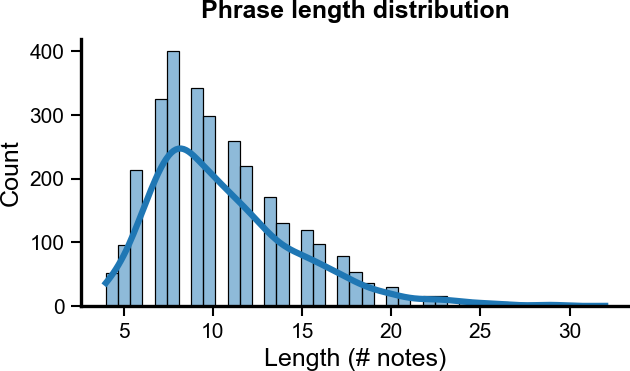

In [9]:
lengths = np.concatenate([dfs['erk']['phrase_length'].values, 
                          dfs['han']['phrase_length'].values, 
                          dfs['liber-antiphons']['phrase_length'].values])

plt.figure(figsize=cm2inch(6, 3))
sns.histplot(lengths, kde=True)
plt.xlabel('Length (# notes)');
plt.title('Phrase length distribution');

In [10]:
def filter_contours(name, min_length=6, max_length=10, dfs=dfs, N=500):
    np.random.seed(0)
    df = dfs[name]
    okay = (df['phrase_length'] >= min_length) & (df['phrase_length'] <= max_length)
    contours = all_contours[name][okay]
    indices = np.random.choice(np.arange(len(contours)), N, replace=False)
    return contours[indices, :], indices

In [16]:
N = 200
erk, erk_idx = filter_contours('erk', 1, 20, N=N)
han, han_idx = filter_contours('han', 1, 20, N=N)
gre, gre_idx = filter_contours('liber-antiphons', 1, 20, N=N)

In [17]:
erk_lengths = dfs['erk']['phrase_length'].values[erk_idx]
erk_durations = dfs['erk']['phrase_duration'].values[erk_idx]
han_lenghts = dfs['han']['phrase_length'].values[han_idx]
han_durations = dfs['han']['phrase_duration'].values[han_idx]
gre_lengths = dfs['liber-antiphons']['phrase_length'].values[gre_idx]
gre_durations = dfs['liber-antiphons']['phrase_duration'].values[gre_idx]

In [18]:
contours = np.concatenate((erk, han, gre), axis=0)
lengths = np.concatenate((erk_lengths, han_lenghts, gre_lengths), axis=0)
durations = np.concatenate((erk_durations, han_durations, gre_durations), axis=0)

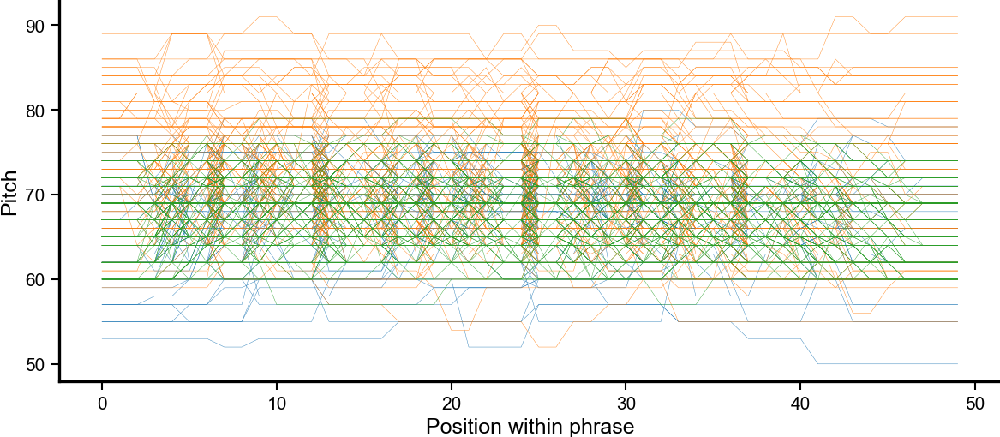

In [19]:
plt.figure(figsize=cm2inch(12,5))
M = 200
plt.plot(contours[:M, :].T, '-', lw=.1, C='C0', label='Erk');
plt.plot(contours[N:N+M, :].T, '-', lw=.1, C='C1', label='Han');
plt.plot(contours[2*N:2*N+M, :].T, '-', lw=.1, C='C2', label='Gregorian');
plt.ylabel('Pitch')
plt.xlabel('Position within phrase');
# plt.legend();

## Helpers

In [20]:
def show_combined_mds(X, fig=True):
    x, y = X.T
    if fig: plt.figure(figsize=cm2inch(6, 5))
    sns.kdeplot(x=x, y=y, levels=5, linewidths=.5, alpha=.4, color='k', label='Overall\ndensity')
    sns.scatterplot(x=x[:N], y=y[:N], s=5, alpha=.5, color="C0", label='Erk')
    sns.scatterplot(x=x[N:2*N], y=y[N:2*N], s=5, alpha=.5, color="C1", label='Han')
    sns.scatterplot(x=x[2*N:], y=y[2*N:], s=5, alpha=.5, color="C2", label='Gregorian')
    plt.ylabel('Coordinate 2')
    plt.xlabel('Coordinate 1')
    plt.legend()
    sns.despine()

In [21]:
def show_combined_tsne(X, fig=True):
    x, y = X.T
    if fig: plt.figure(figsize=cm2inch(6, 5))
    sns.kdeplot(x=x, y=y, levels=5, linewidths=.5, alpha=.2, color='k', label='Overall\ndensity')
    sns.scatterplot(x=x[:N], y=y[:N], s=5, alpha=.5, color="C0", label='Erk')
    sns.scatterplot(x=x[N:2*N], y=y[N:2*N], s=5, alpha=.5, color="C1", label='Han')
    sns.scatterplot(x=x[2*N:], y=y[2*N:], s=5, alpha=.5, color="C2", label='Gregorian')
    plt.ylabel('Coordinate 2')
    plt.xlabel('Coordinate 1')
    plt.legend()
    sns.despine()

In [22]:
def show_combined_similarity(dm):
    sns.kdeplot(dm.ravel())
    plt.xlabel('Similarity')

In [23]:
def show_similarity(dm):
    sns.kdeplot(dm.ravel())
    plt.xlabel('Similarity')

In [24]:
def show_space_combined(X_mds, X_tsne, dm):
    plt.figure(figsize=cm2inch(16, 5))
    
    ax1 = plt.subplot(131)
    plt.title('MDS')
    show_mds(X_mds, fig=False)
    
    ax2 = plt.subplot(132)
    plt.title('t-SNE')
    show_tsne(X_tsne, fig=False)
    plt.legend([])
    
    ax3 = plt.subplot(133)
    plt.title('Pairwise similarity distribution')
    show_similarity_dist(dm)

    return ax1, ax2, ax3

In [25]:
def ylabel_matrix(text, y, pad=-5):
    plt.gca().annotate(text, xy=(0, y), xytext=(pad, 0),
                       xycoords='axes fraction', textcoords='offset points',
                       va='center', ha='right', rotation=90, fontsize='small')
    
def xlabel_matrix(text, x, pad=-5):
    plt.gca().annotate(text, xy=(x, 0), xytext=(0, pad),
                       xycoords='axes fraction', textcoords='offset points',
                       va='top', ha='center', fontsize='small')

def show_similarity_matrix(dm):
    plt.imshow(dm, cmap='Blues')
    plt.axvline(N, c='k', ls='--', lw=.5)
    plt.axvline(2*N, c='k', ls='--', lw=.5)
    plt.axhline(N, c='k', ls='--', lw=.5)
    plt.axhline(2*N, c='k', ls='--', lw=.5)
    plt.axis('off')
    ax = plt.gca()
    ylabel_matrix('Erk', 5/6)
    ylabel_matrix('Han', 1/2)
    ylabel_matrix('Gregorian', 1/6)
    xlabel_matrix('Erk', 1/6)
    xlabel_matrix('Han', 1/2)
    xlabel_matrix('Gregorian', 5/6)
    
# show_similarity_matrix(eucl_dm)

In [26]:
def get_tsnes(dm, perplexities=[5, 30, 50], n_iter=3000):
    Xs = dict()
    for perplexity in perplexities:
        tsne = TSNE(n_components=2, random_state=0, metric='precomputed', perplexity=perplexity, n_iter=n_iter)
        Xs[perplexity] = tsne.fit_transform(dm)
    return Xs

In [27]:
def _show_tsne_perplexity(Xs, index, bw_adjust=0.5):
    perplexity = list(Xs.keys())[index]
    plt.title(f't-SNE at perplexity {perplexity}')
    x, y = Xs[perplexity].T
    sns.kdeplot(x=x, y=y, levels=5, linewidths=.5, alpha=.4, color='k', bw_adjust=bw_adjust)
    sns.scatterplot(x=x[:N], y=y[:N], s=3, alpha=.5, color="C0")
    sns.scatterplot(x=x[N:2*N], y=y[N:2*N], s=3, alpha=.5, color="C1")
    sns.scatterplot(x=x[2*N:], y=y[2*N:], s=3, alpha=.5, color="C2")
    plt.axis('off')

def show_space(X_mds, X_tsnes, dm, fig=True, bw_adjust=1):
    if fig: plt.figure(figsize=cm2inch(15, 8))
    scatter_kwds = dict(s=10, alpha=.3, lw=0)
    
    plt.subplot(241)
    sns.kdeplot(dm[:N, :N].ravel(), color="C0", label='Erk', bw_adjust=bw_adjust)
    sns.kdeplot(dm[N:2*N, N:2*N].ravel(), color="C1", label='Han', bw_adjust=bw_adjust)
    sns.kdeplot(dm[2*N:, 2*N:].ravel(), color="C2", label='Gre.', bw_adjust=bw_adjust)
    sns.kdeplot(dm.ravel(), color="k", shade=True, alpha=0.1, lw=0, label='Aggr.', bw_adjust=bw_adjust)
    plt.title('Pairwise dissimilarity distr.')
    plt.xlabel('dissimilarity')
    plt.legend()
    
    plt.subplot(245)
    show_similarity_matrix(dm)
    plt.title('Dissimilarity matrix')

    x, y = X_mds.T    
    ax1 = plt.subplot(242)
    sns.kdeplot(x=x, y=y, levels=5, linewidths=.5, alpha=.4, color='k', label='Aggregate\ndensity', bw_adjust=bw_adjust)
    plt.scatter(x[:N], y[:N], color="C0", **scatter_kwds)
    plt.title('MDS of Erk')
    plt.legend()
    
    plt.subplot(243)
    sns.kdeplot(x=x, y=y, levels=5, linewidths=.5, alpha=.4, color='k', bw_adjust=bw_adjust)
    plt.scatter(x[N:2*N], y[N:2*N], color="C1", label='Han', **scatter_kwds)
    plt.title('MDS of Han')

    plt.subplot(244)
    sns.kdeplot(x=x, y=y, levels=5, linewidths=.5, alpha=.4, color='k', bw_adjust=bw_adjust)
    plt.scatter(x[2*N:], y[2*N:], color="C2", label='Han', **scatter_kwds)
    plt.title('MDS of Gregorian')
    
    perplexities = list(X_tsnes.keys())
    plt.subplot(246)
    _show_tsne_perplexity(X_tsnes, 0, bw_adjust=bw_adjust)
    
    plt.subplot(247)
    _show_tsne_perplexity(X_tsnes, 1, bw_adjust=bw_adjust)

    plt.subplot(248)
    _show_tsne_perplexity(X_tsnes, 2, bw_adjust=bw_adjust)
    
    sns.despine()
    plt.tight_layout()
    
# show_space(X_eucl_mds, X_eucl_tsnes, eucl_dm)

In [28]:
mds = MDS(n_components=2, random_state=0, dissimilarity='precomputed', metric=True)
nonmetric_mds = MDS(n_components=2, random_state=0, dissimilarity='precomputed', metric=False)

## Euclidean distance

The first step, therefore, is to look for **clusters** or **modes** in the distribution of contours. We start this search visually by plotting the contours in a 2 dimensional representation. To reduce the dimensionality we will use multidimensional scaling as it only relies on a distance or similarity matrix. This allows us to use it with non-euclidean similarity measures such as dynamic time warping similarity. 

We apply multidimensional scaling to phrase contours from three traditions: German (`erk`), Chinese (`han`) and Gregorian chant (`antiphons`). We use the Euclidean distance. And so in the resulting embedding, MDS tries to preserve the Euclidean distances between the phrases, treating them all as points 50 dimensional space. If there are any modes in the space, they should show up in the MDS embedding.

In [29]:
# eucl_dm = distance_matrix(contours, contours)

In [30]:
eucl_dm = distance_matrix(contours, contours)
X_eucl_mds = mds.fit_transform(eucl_dm)
X_eucl_tsnes = get_tsnes(eucl_dm, n_iter=500)

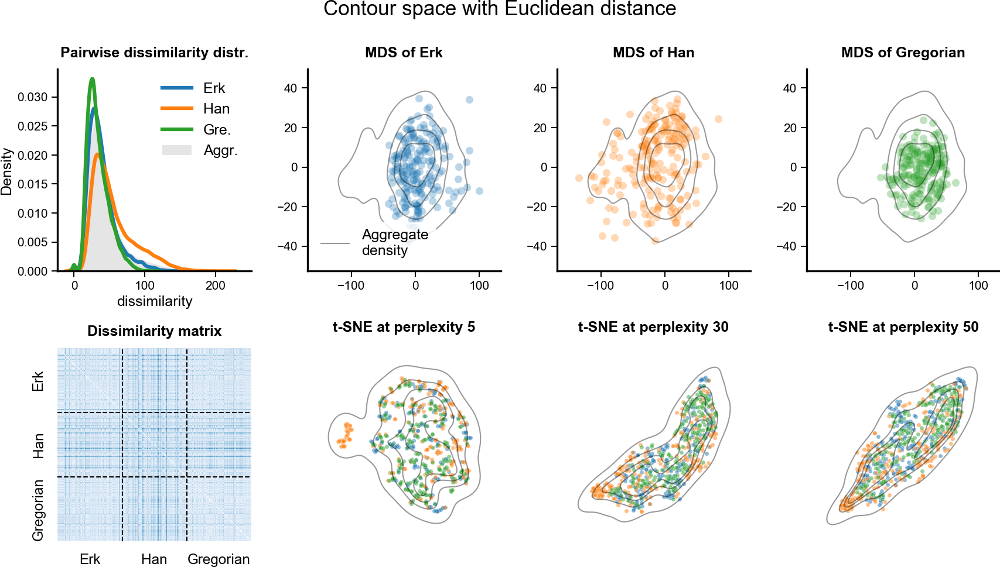

In [31]:
show_space(X_eucl_mds, X_eucl_tsnes, eucl_dm)
plt.suptitle('Contour space with Euclidean distance', y=1.05);
plt.savefig('../figures/fig-space-eucl.pdf')

The 'overall' density of all phrases is unimodal, as shown by the gray lines. Different traditions do occupy different parts of this embedding space, but that may be an artefact of being transcribed at different octaves. Since we have *not* normalized the overall pitch of the phrases, big distances are mostly caused by phrases having a very different average pitch height: being transcribed an octave higher or lower, for example. MDS picks up on this. This is illustrated by the contours (B) of some of the outliers in the MDS embedding (A). Plot C also shows that most of the variation in the MDS embedding is explained by pitch height: the principal component of the MDS embedding (yes, that's right) correlates with the pitch height of the phrases.

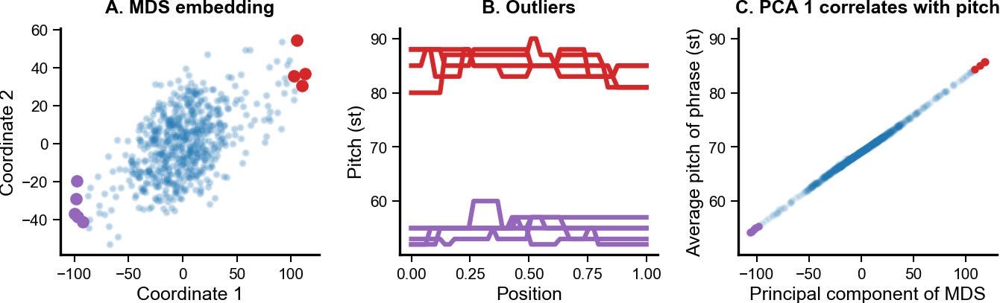

In [33]:
plt.figure(figsize=cm2inch(12, 4))
x, y = X_eucl_mds.T

pca = PCA(n_components=1)
y_pca = pca.fit_transform(X_eucl_mds)
avg_pitch = contours.mean(axis=1)
plt.plot(avg_pitch, y_pca, '.')

# Select outliers based on PCA
y_values = sorted(y_pca.ravel())
lower, upper = y_values[5], y_values[-5]
outliers1 = np.where(y_pca > upper)[0]
outliers2 = np.where(y_pca < lower)[0]

plt.subplot(131)
plt.scatter(x, y, alpha=.2, s=2)
plt.scatter(x[outliers1], y[outliers1], c='C3')
plt.scatter(x[outliers2], y[outliers2], c='C4')
plt.title('A. MDS embedding')
plt.ylabel('Coordinate 2')
plt.xlabel('Coordinate 1')

ax2 = plt.subplot(132)
plt.plot(np.linspace(0, 1, 50), contours[outliers1, :].T, c='C3');
plt.plot(np.linspace(0, 1, 50), contours[outliers2, :].T, c='C4');
plt.title('B. Outliers')
plt.ylabel('Pitch (st)')
plt.xlabel('Position')

plt.subplot(133, sharey=ax2)
plt.plot(y_pca, contours.mean(axis=1), '.', alpha=.1)
plt.plot(y_pca[outliers1], contours.mean(axis=1)[outliers1], '.', c='C3')
plt.plot(y_pca[outliers2], contours.mean(axis=1)[outliers2], '.', c='C4')
plt.title('C. PCA 1 correlates with pitch')
plt.xlabel('Principal component of MDS')
plt.ylabel('Average pitch of phrase (st)')
sns.despine()

plt.tight_layout()

### t-SNE perplexity

In [29]:
Xs_eucl = get_tsnes(eucl_dm, perplexities=[2, 5, 30, 50, 100])

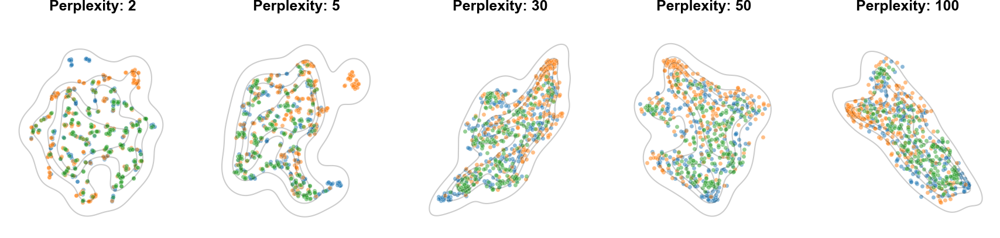

In [30]:
def show_tsne_perplexities(Xs):
    perplexities = list(Xs.keys())
    plt.figure(figsize=cm2inch(len(perplexities)*3, 4))
    for i, p in enumerate(perplexities):
        plt.subplot(int(f'1{len(perplexities)}{i+1}'))
        plt.title(f'Perplexity: {p}')
        x, y = Xs[p].T
        sns.kdeplot(x=x, y=y, levels=5, linewidths=.5, alpha=.2, color='k')
        sns.scatterplot(x=x[:N], y=y[:N], s=3, alpha=.5, color="C0")
        sns.scatterplot(x=x[N:2*N], y=y[N:2*N], s=3, alpha=.5, color="C1")
        sns.scatterplot(x=x[2*N:], y=y[2*N:], s=3, alpha=.5, color="C2")
        plt.axis('off')
    plt.tight_layout()
    
show_tsne_perplexities(Xs_eucl)

## Pitch centering

All this just stresses that we need to account differences in overall pitch height in some way. A first step would be transposing all phrases to lie in roughly the same octave. This would however not resolve the problem: two identical contours at different places in the octave would still be relatively far apart. To address that one could transpose all phrases to have comparable pitch range, for example to have mean pitch 0. 

That is what I will do for now. Later I will also consider an alternative way to resolve the pitch normalization and use a representation that is in variant under transposition (the intervals between successive pitches, or the derivative of the contour).

In [32]:
centered_contours = contours - contours.mean(axis=1)[:, np.newaxis]

In [33]:
centered_eucl_dm = distance_matrix(centered_contours, centered_contours)
X_centered_eucl_mds = mds.fit_transform(centered_eucl_dm)
X_centered_eucl_tsnes = get_tsnes(centered_eucl_dm)

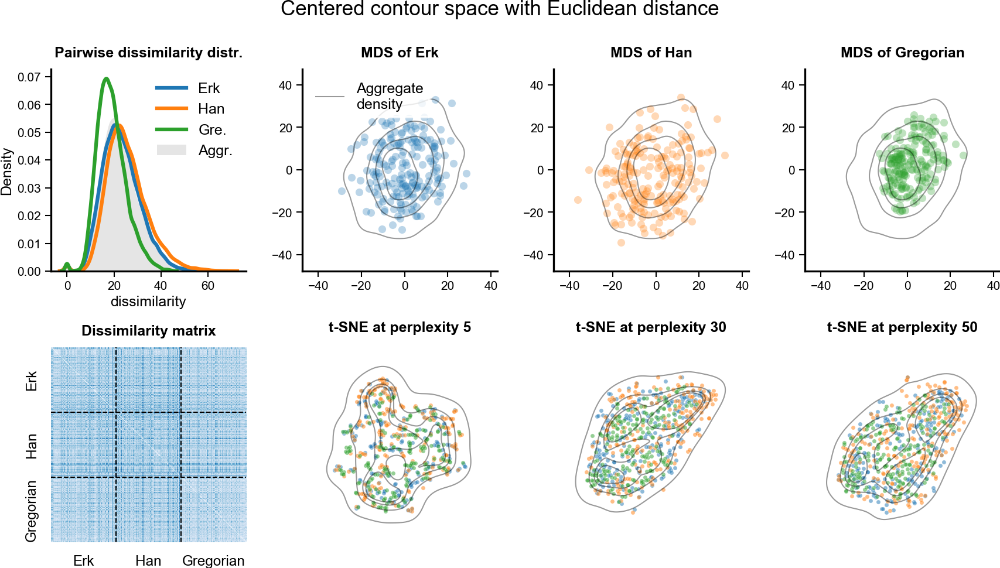

In [34]:
show_space(X_centered_eucl_mds, X_centered_eucl_tsnes, centered_eucl_dm)
plt.suptitle('Centered contour space with Euclidean distance', y=1.05);

And of course the correlation with overall pitch height disappears:

In [35]:
def plot_pca_outliers(X, outliers=5):
    plt.figure(figsize=cm2inch(8, 4))
    x, y = X.T
    pca = PCA(n_components=1)
    y_pca = pca.fit_transform(X)

    # Select outliers based on PCA
    y_values = sorted(y_pca.ravel())
    lower, upper = y_values[outliers], y_values[-outliers]
    outliers1 = np.where(y_pca > upper)[0]
    outliers2 = np.where(y_pca < lower)[0]

    plt.subplot(121)
    plt.scatter(x, y, alpha=.2, s=2)
    plt.scatter(x[outliers1], y[outliers1], c='C3')
    plt.scatter(x[outliers2], y[outliers2], c='C4')
    plt.title('A. MDS embedding')
    plt.ylabel('Coordinate 2')
    plt.xlabel('Coordinate 1')

    ax2 = plt.subplot(122)
    plt.plot(np.linspace(0, 1, 50), contours[outliers1, :].T, c='C3');
    plt.plot(np.linspace(0, 1, 50), contours[outliers2, :].T, c='C4');
    plt.title('B. Outliers')
    plt.ylabel('Pitch (st)')
    plt.xlabel('Position')
    sns.despine()

    plt.tight_layout()

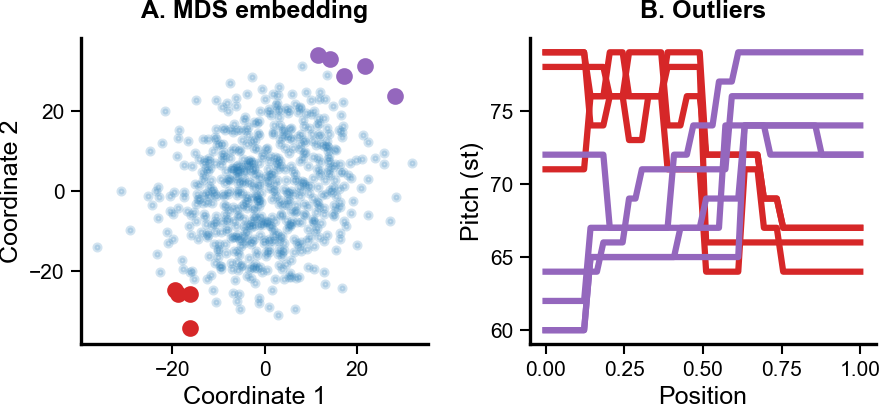

In [36]:
plot_pca_outliers(X_centered_eucl_mds)

The outliers suggest that the MDS coordinates may have a simple interpretation. The red outliers on the left correspond to ascending contours, and the purple outliers on the right to descending ones. However the distribution is unimodal: we do not see multiple clusters of contour shapes such as ascending or descending ones. Rather, there is a continuum of contours from ascending to descending ones—under an Euclidian distance metric, that is.

Indeed the dip-dist cannot reject that these distributions are unimodal.

## Pitch normalization

In [130]:
maxima = contours.max(axis=1)[:, np.newaxis]
minima = contours.min(axis=1)[:, np.newaxis]
normalized_contours = (contours - minima) / (maxima - minima)

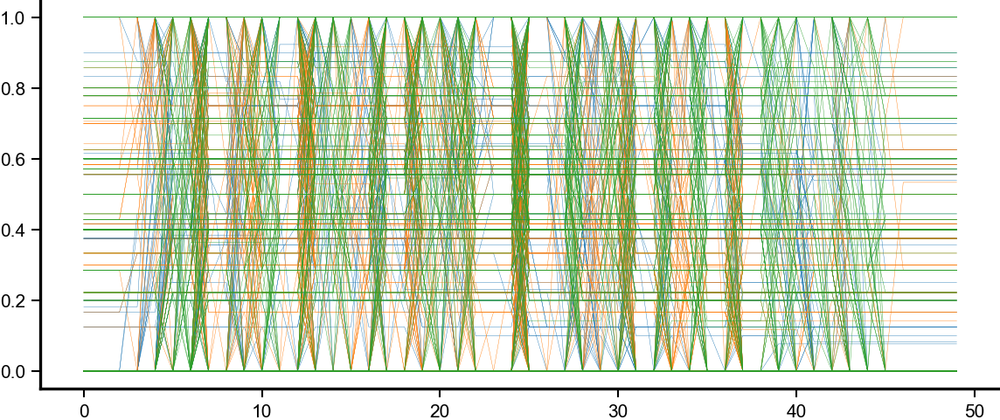

In [132]:
plt.figure(figsize=cm2inch(12,5))
plt.plot(normalized_contours[:N, :].T, '-', lw=.1, C='C0', label='Erk');
plt.plot(normalized_contours[N:2*N].T, '-', lw=.1, C='C1', label='Han');
plt.plot(normalized_contours[2*N:].T, '-', lw=.1, C='C2', label='Gregorian');

In [133]:
normalized_eucl_dm = distance_matrix(normalized_contours, normalized_contours)
X_normalized_eucl_mds = mds.fit_transform(normalized_eucl_dm)
X_normalized_eucl_tsnes = get_tsnes(normalized_eucl_dm)

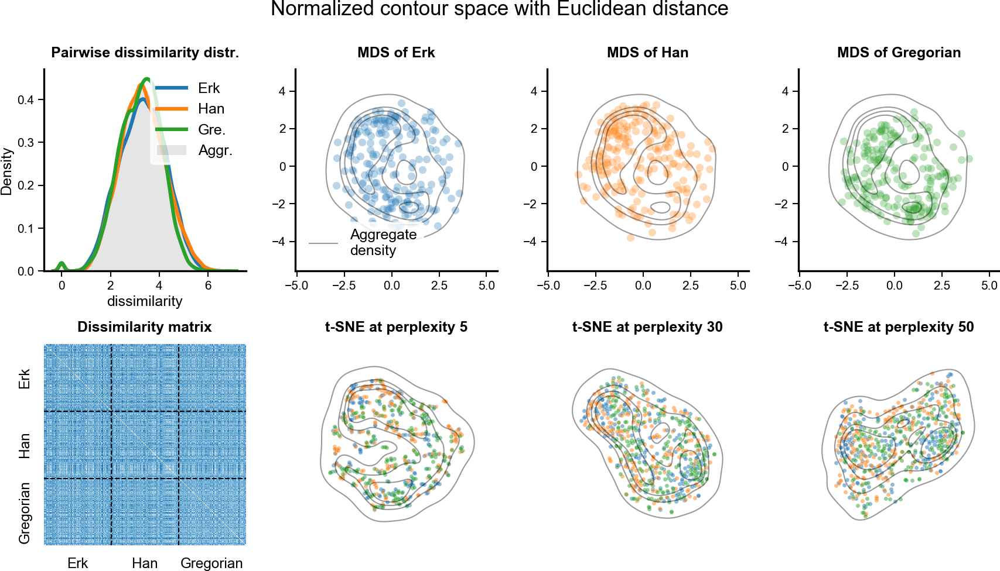

In [134]:
show_space(X_normalized_eucl_mds, X_normalized_eucl_tsnes, normalized_eucl_dm)
plt.suptitle('Normalized contour space with Euclidean distance', y=1.05);

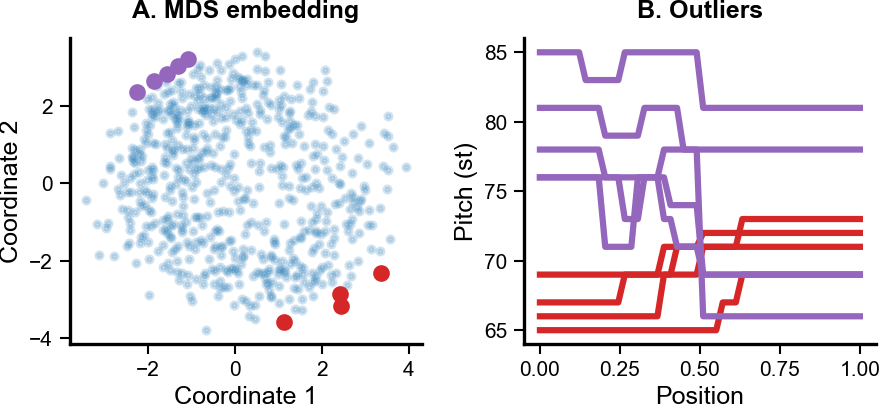

In [142]:
plot_pca_outliers(X_normalized_eucl_mds)

## Other distances

### Cosine distance

In [144]:
from scipy.spatial.distance import cdist

In [147]:
normalized_cosine_dm = cdist(normalized_contours, normalized_contours, metric='cosine')
X_normalized_cosine_mds = mds.fit_transform(normalized_cosine_dm)
X_normalized_cosine_tsnes = get_tsnes(normalized_cosine_dm)

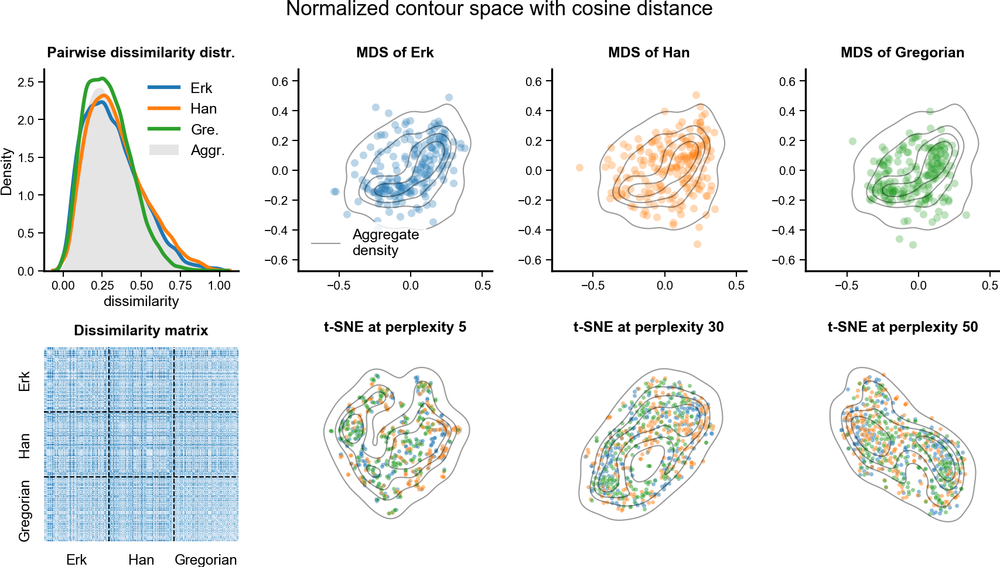

In [151]:
show_space(X_normalized_cosine_mds, X_normalized_cosine_tsnes, normalized_cosine_dm)
plt.suptitle('Normalized contour space with cosine distance', y=1.05);

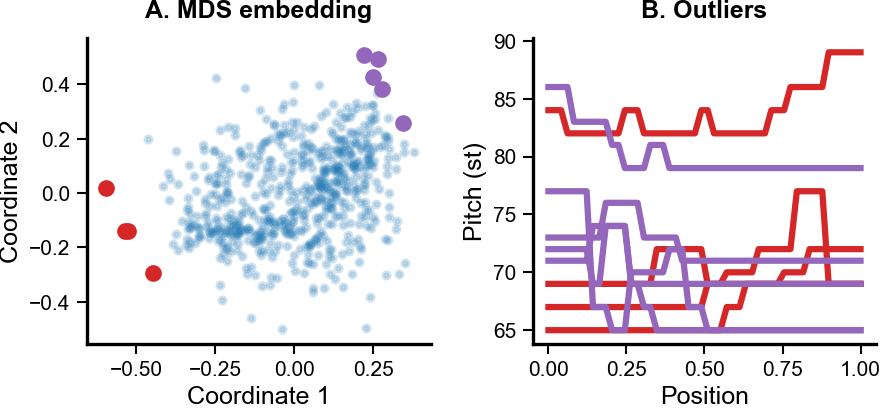

In [150]:
plot_pca_outliers(X_normalized_cosine_mds)

### Correlation distance

In [153]:
normalized_corr_dm = cdist(normalized_contours, normalized_contours, metric='correlation')
X_normalized_corr_mds = mds.fit_transform(normalized_corr_dm)
X_normalized_corr_tsnes = get_tsnes(normalized_corr_dm)

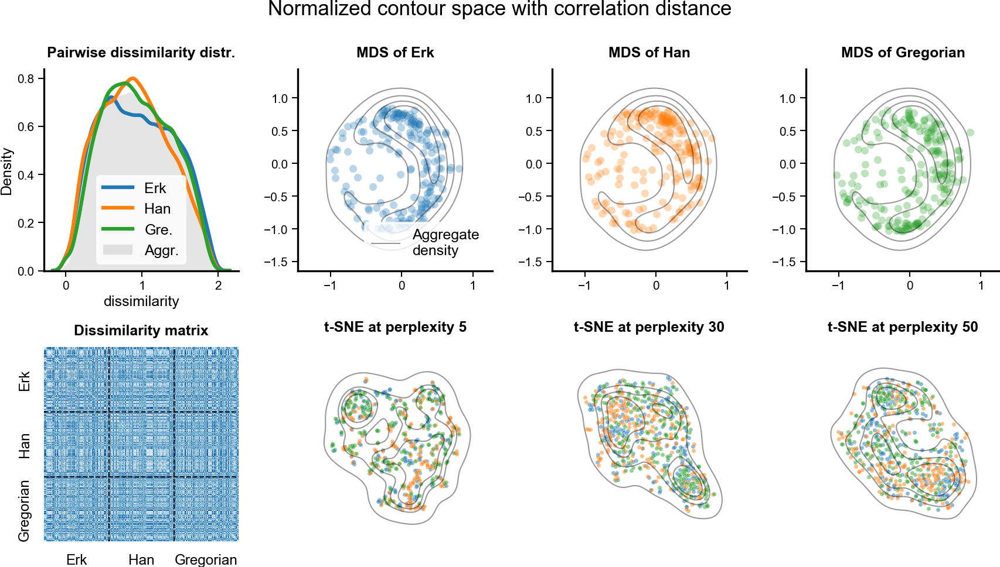

In [154]:
show_space(X_normalized_corr_mds, X_normalized_corr_tsnes, normalized_corr_dm)
plt.suptitle('Normalized contour space with correlation distance', y=1.05);

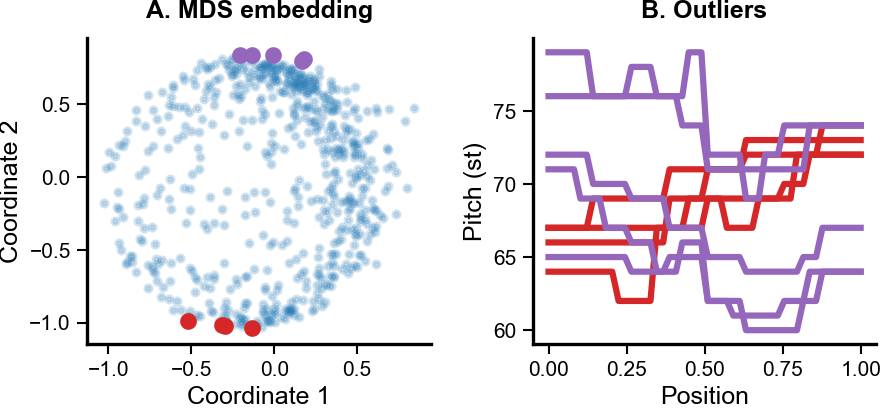

In [155]:
plot_pca_outliers(X_normalized_corr_mds)

## Dynamic Time Warping

In [61]:
dtw_dm = cdist_dtw(centered_contours, global_constraint="sakoe_chiba", sakoe_chiba_radius=20)

In [66]:
X_dtw_mds = mds.fit_transform(dtw_dm)

In [67]:
X_dtw_tsnes = get_tsnes(dtw_dm)

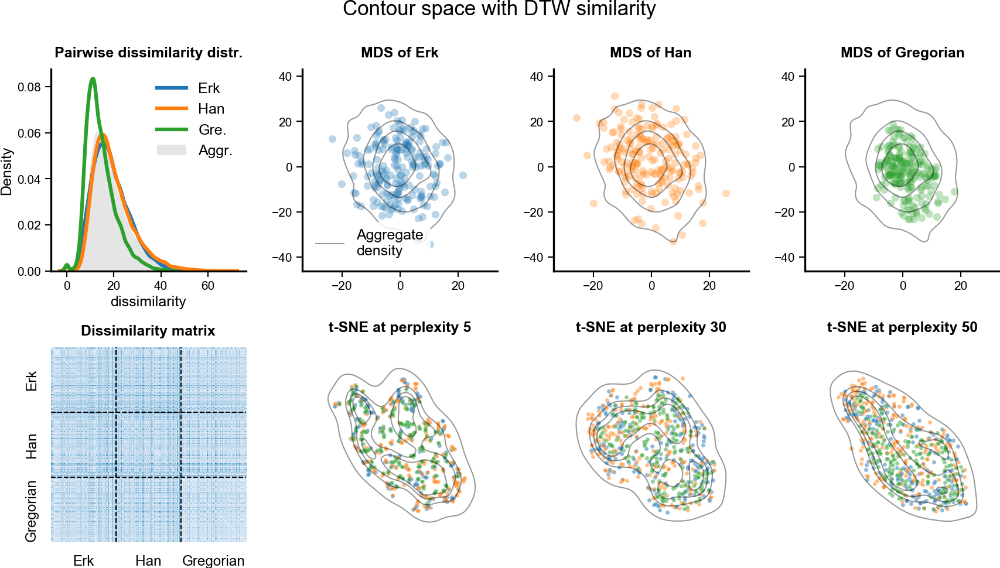

In [68]:
show_space(X_dtw_mds, X_dtw_tsnes, dtw_dm)
plt.suptitle('Contour space with DTW similarity', y=1.05);

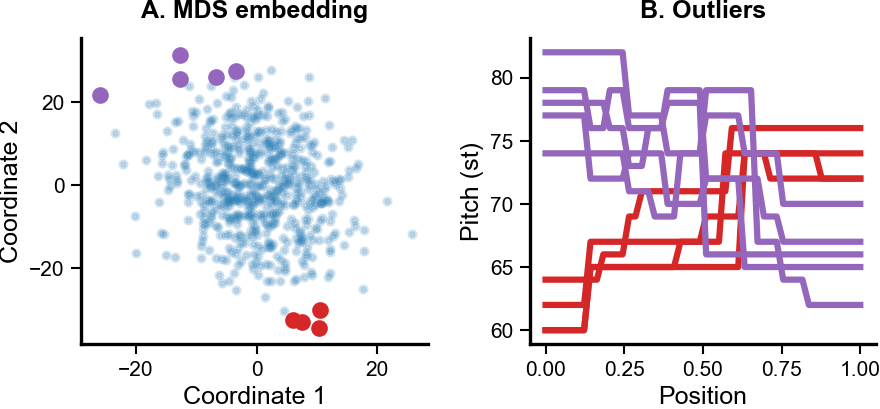

In [69]:
plot_pca_outliers(X_dtw_mds)

### Normalized contours

In [135]:
normalized_dtw_dm = cdist_dtw(normalized_contours, global_constraint="sakoe_chiba", sakoe_chiba_radius=20)

In [137]:
X_normalized_dtw_mds = mds.fit_transform(normalized_dtw_dm)

In [138]:
X_normalized_dtw_tsnes = get_tsnes(normalized_dtw_dm)

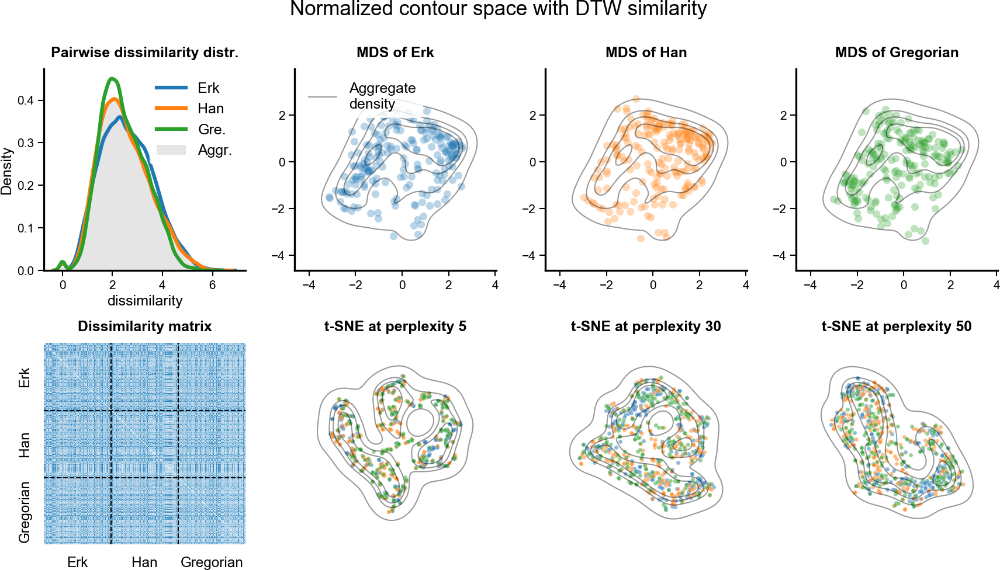

In [139]:
show_space(X_normalized_dtw_mds, X_normalized_dtw_tsnes, normalized_dtw_dm)
plt.suptitle('Normalized contour space with DTW similarity', y=1.05);

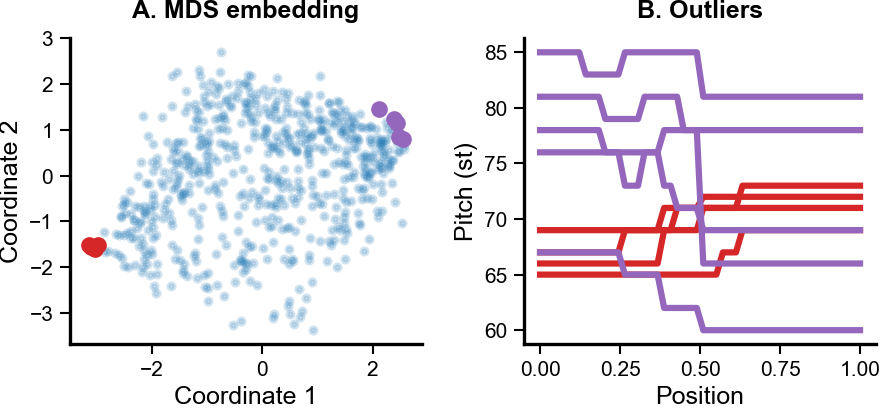

In [140]:
plot_pca_outliers(X_normalized_dtw_mds)

### Nonmetric MDS

In [70]:
X_dtw_nonmetric_mds = nonmetric_mds.fit_transform(dtw_dm)

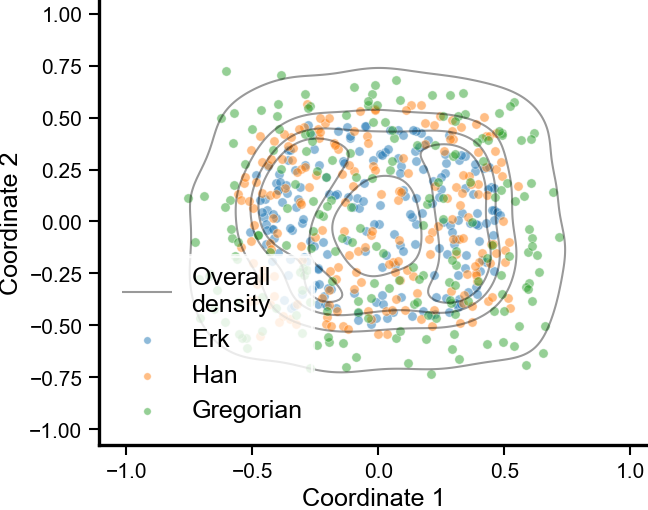

In [73]:
show_combined_mds(X_dtw_nonmetric_mds)

In [74]:
# show_combined_mds(X_dtw_nonmetric)
# plt.title('Non-metric MDS embedding of DTW similarity', fontweight='bold');

### Soft DTW

In [75]:
from tslearn.metrics import cdist_soft_dtw

In [76]:
soft_dtw_dm = cdist_soft_dtw(norm_contours, gamma=.1)

In [94]:
soft_dtw_dm_clipped = np.clip(soft_dtw_dm, 0, np.inf)

In [95]:
X_soft_dtw_mds = mds.fit_transform(soft_dtw_dm_clipped)

In [96]:
X_soft_dtw_tsnes = get_tsnes(soft_dtw_dm_clipped)

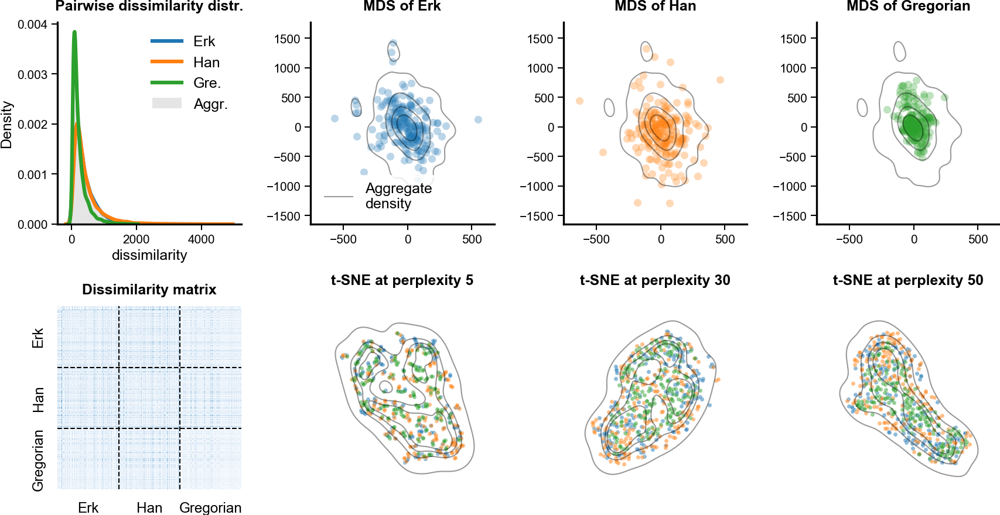

In [97]:
show_space(X_soft_dtw_mds, X_soft_dtw_tsnes, soft_dtw_dm)

## Derivative DTW

Goal of this notebook is to convert a matrix of contours into a matrix of contour derivatives. We are not computing actual derivatives, but approximating the derivatives in two different ways. First, given a contour $X = (x_1, \dots, x_n)$ 

$$X' = (x_2-x_1, x_3-x_2, \dots, x_n-x_{n-1}, 0)$$

This is simply the interval from every pitch to the next, and the final interval is set to 0 (the final note has some duration).

This is closely related to derivative dynamic time warping, but slightly different. There smoothen the derivative by taking the average of the slope between the previous and the current point, and the slope between the previous and the next point:

$$x'_i = \frac{1}{2}\Bigl[ \frac{x_i - x_{i-1}}{1} + \frac{x_{i+1} - x_{i-1}}{2}\Bigr] $$

Moreover, as the cost function in DWT they do not use the Euclidian distance but the squared difference between the derivatives.

In [98]:
def derivative(timeseries, smooth=False):
    d1 = timeseries[:, 1:] - timeseries[:, :-1]
    zeros = np.zeros((timeseries.shape[0], 1))
    if smooth:
        d2 = (timeseries[:, 2:] - timeseries[:, :-2]) / 2
        avg = (d1[:, 1:] + d2) / 2
        return np.concatenate((zeros, avg, zeros), axis=1) 
    else:
        return np.append(d1, zeros, axis=1) 
    
def integrate(derivatives):
    return np.append(
        np.zeros((derivatives.shape[0], 1)), 
        np.cumsum(derivatives, axis=1)[:, :-1], 
        axis=1)

In [99]:
demo_contours = np.array([
    [1, 1, 1, 1, 1, 1, 1],
    [1, 2, 3, 4, 3, 2, 1],
    [1, 2, 3, 4, 5, 6, 7],
    [7, 6, 5, 4, 3, 2, 1],
    [3, 4, 3, 2, 1, 2, 3]
])

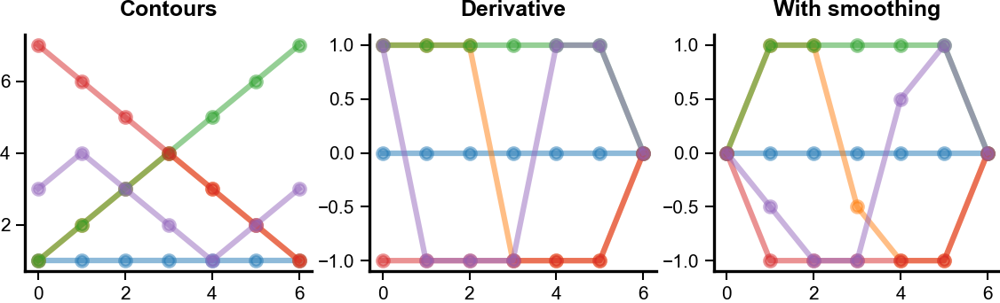

In [100]:
plt.figure(figsize=cm2inch(12, 3))
plt.subplot(131)
plt.title('Contours')
plt.plot(demo_contours.T, marker='o', alpha=.5)

plt.subplot(132)
plt.title('Derivative')
plt.plot(derivative(demo_contours, smooth=False).T, marker='o', alpha=.5)

plt.subplot(133)
plt.title('With smoothing')
plt.plot(derivative(demo_contours, smooth=True).T, marker='o', alpha=.5);


In [109]:
intervals = derivative(contours, smooth=False)
intervals_smooth = derivative(contours, smooth=True)

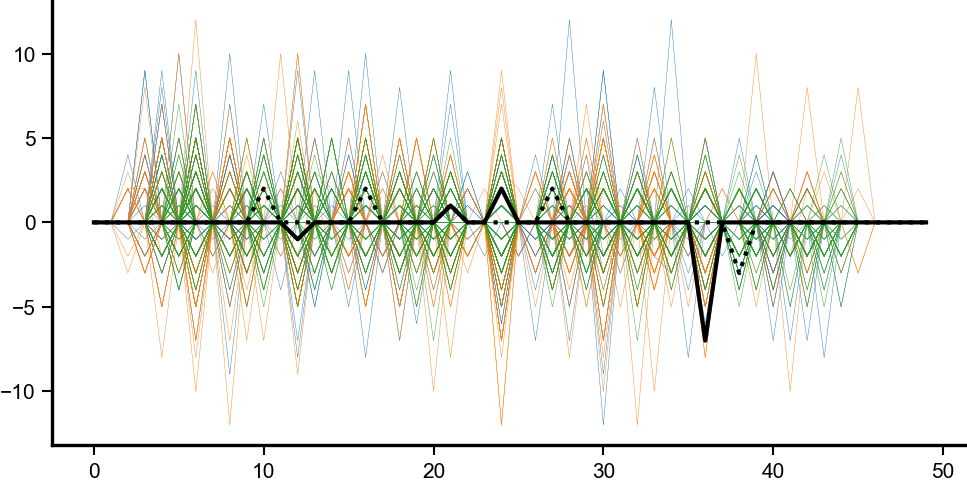

In [102]:
plt.figure(figsize=cm2inch(10,5))

plt.plot(intervals[:N, :].T, '-', lw=.1, C='C0');
plt.plot(intervals[N:2*N, :].T, '-', lw=.1, C='C1');
plt.plot(intervals[2*N:, :].T, '-', lw=.1, C='C2');

plt.plot(intervals[1, :].T, 'k-', lw=1);
plt.plot(intervals[2, :].T, 'k:', lw=1);

In [103]:
intervals_dm = cdist_dtw(intervals, global_constraint="sakoe_chiba", sakoe_chiba_radius=20)

In [104]:
X_intervals_mds = mds.fit_transform(intervals_dm)

In [106]:
X_intervals_tsnes = get_tsnes(intervals_dm)

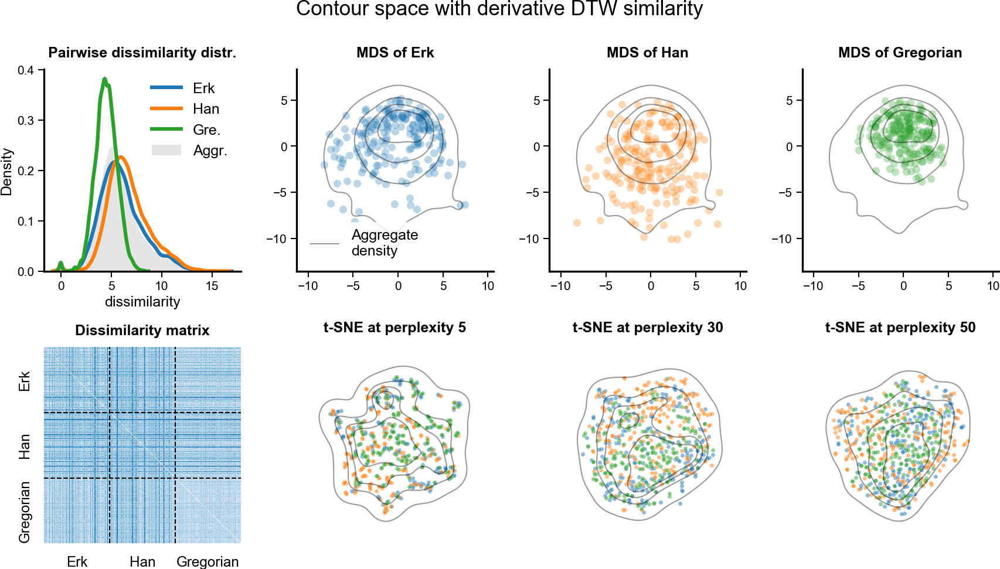

In [107]:
show_space(X_intervals_mds, X_intervals_tsnes, intervals_dm)
plt.suptitle('Contour space with derivative DTW similarity', y=1.05);

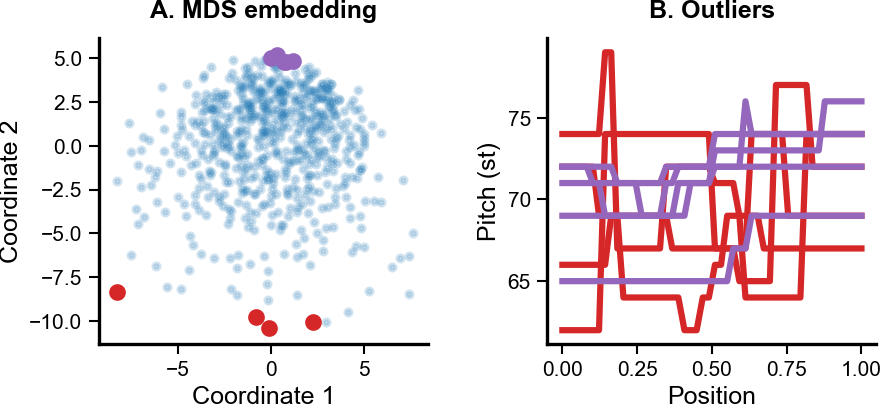

In [108]:
plot_pca_outliers(X_intervals_mds)

### Smoothed

In [110]:
intervals_smooth_dm = cdist_dtw(intervals_smooth, global_constraint="sakoe_chiba", sakoe_chiba_radius=20)

In [111]:
X_intervals_smooth_mds = mds.fit_transform(intervals_smooth_dm)

In [112]:
X_intervals_smooth_tsnes = get_tsnes(intervals_smooth_dm)

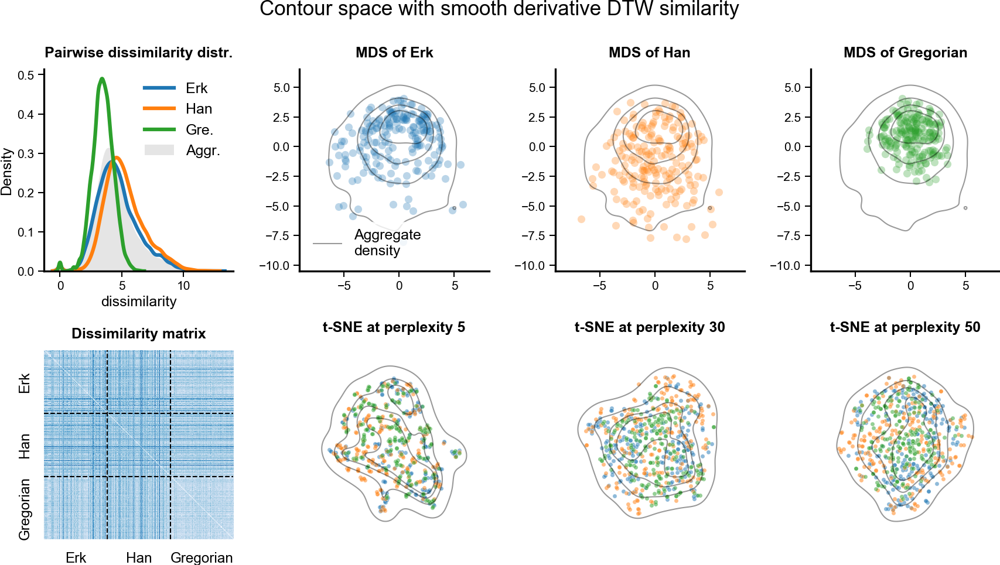

In [113]:
show_space(X_intervals_smooth_mds, X_intervals_smooth_tsnes, intervals_smooth_dm)
plt.suptitle('Contour space with smooth derivative DTW similarity', y=1.05);

## Curse of dimensionality

#### Skip 1

In [184]:
centered_countours_skip_1 = centered_contours[:, np.arange(0, 50, 2)]
centered_skip_1_eucl_dm = distance_matrix(centered_countours_skip_1, centered_countours_skip_1)
X_centered_skip_1_eucl_mds = mds.fit_transform(centered_skip_1_eucl_dm)
X_centered_skip_1_eucl_tsnes = get_tsnes(centered_skip_1_eucl_dm)

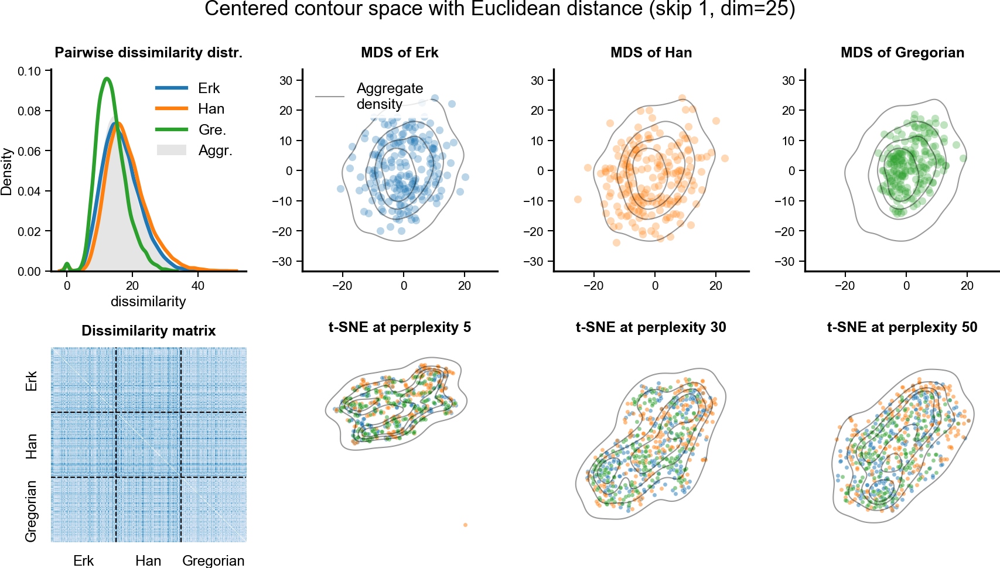

In [188]:
show_space(X_centered_skip_1_eucl_mds, X_centered_skip_1_eucl_tsnes, centered_skip_1_eucl_dm)
plt.suptitle(f'Centered contour space with Euclidean distance (skip 1, dim={centered_countours_skip_1.shape[1]})', y=1.05);

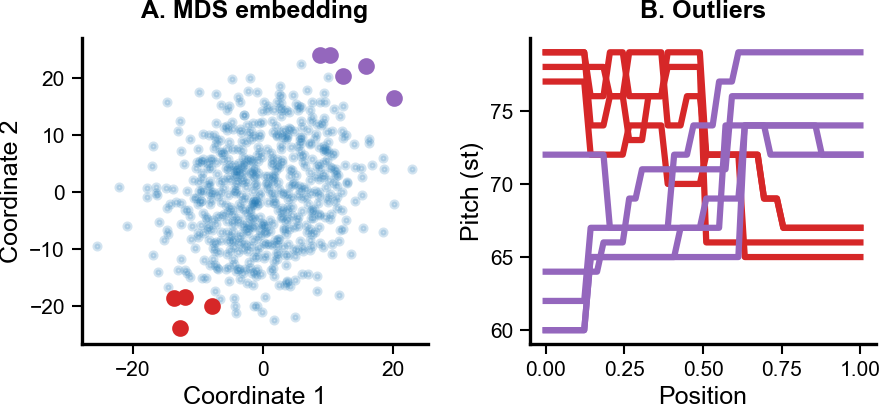

In [191]:
plot_pca_outliers(X_centered_skip_1_eucl_mds)

#### Skip 3

In [189]:
centered_countours_skip_3 = centered_contours[:, np.arange(0, 50, 4)]
centered_skip_3_eucl_dm = distance_matrix(centered_countours_skip_3, centered_countours_skip_3)
X_centered_skip_3_eucl_mds = mds.fit_transform(centered_skip_3_eucl_dm)
X_centered_skip_3_eucl_tsnes = get_tsnes(centered_skip_3_eucl_dm)

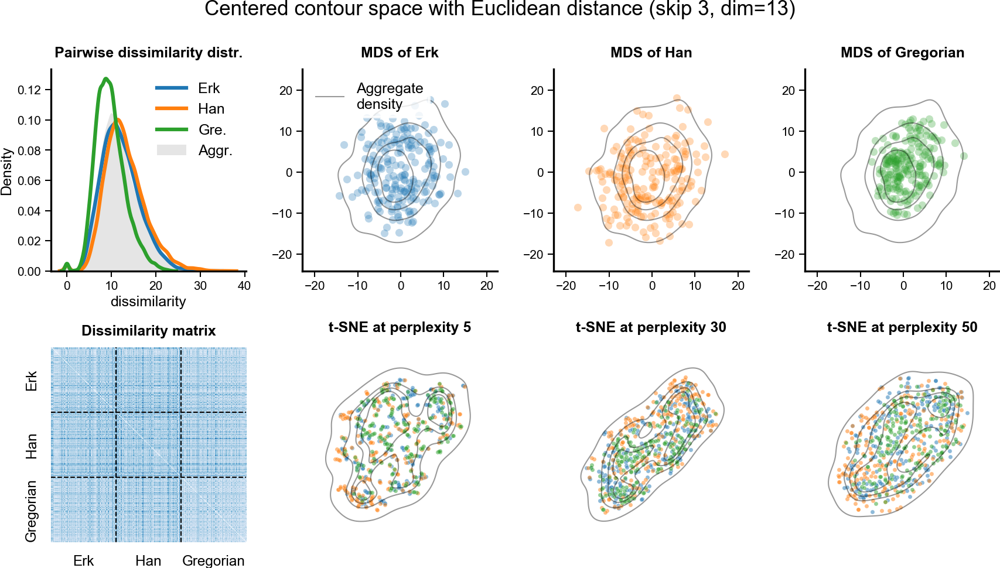

In [190]:
show_space(X_centered_skip_3_eucl_mds, X_centered_skip_3_eucl_tsnes, centered_skip_3_eucl_dm)
plt.suptitle(f'Centered contour space with Euclidean distance (skip 3, dim={centered_countours_skip_3.shape[1]})', y=1.05);

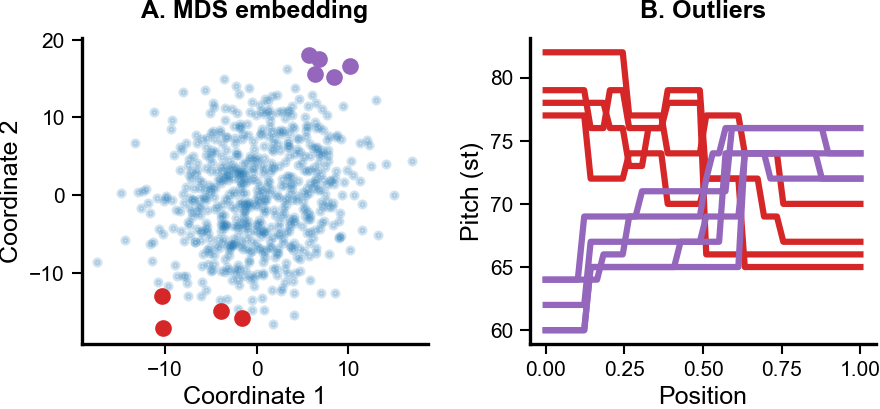

In [192]:
plot_pca_outliers(X_centered_skip_3_eucl_mds)

#### Skip 7

In [195]:
centered_countours_skip_7 = centered_contours[:, np.arange(0, 50, 8)]
centered_skip_7_eucl_dm = distance_matrix(centered_countours_skip_7, centered_countours_skip_7)
X_centered_skip_7_eucl_mds = mds.fit_transform(centered_skip_7_eucl_dm)
X_centered_skip_7_eucl_tsnes = get_tsnes(centered_skip_7_eucl_dm)

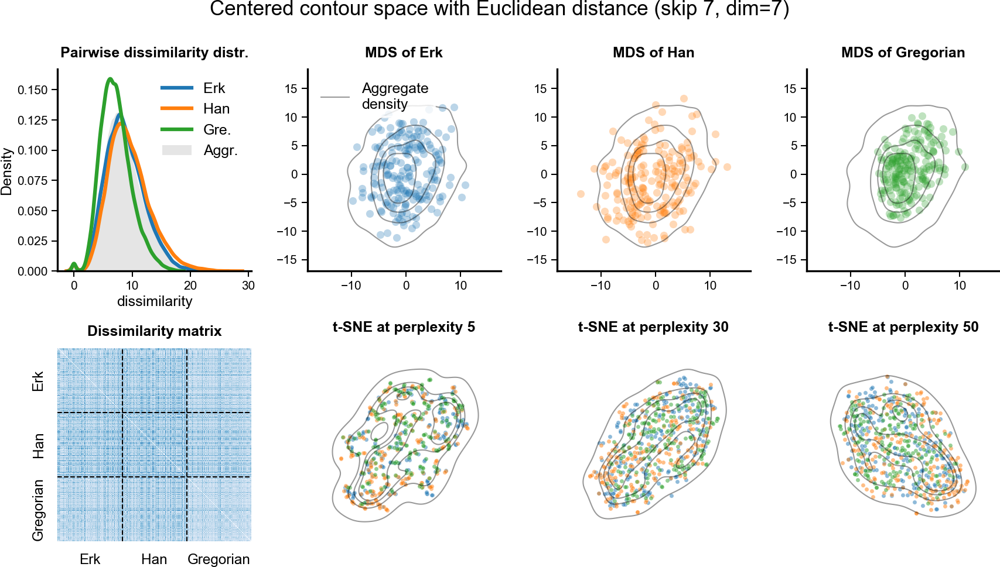

In [197]:
show_space(X_centered_skip_7_eucl_mds, X_centered_skip_7_eucl_tsnes, centered_skip_7_eucl_dm)
plt.suptitle(f'Centered contour space with Euclidean distance (skip 7, dim={centered_countours_skip_7.shape[1]})', y=1.05);

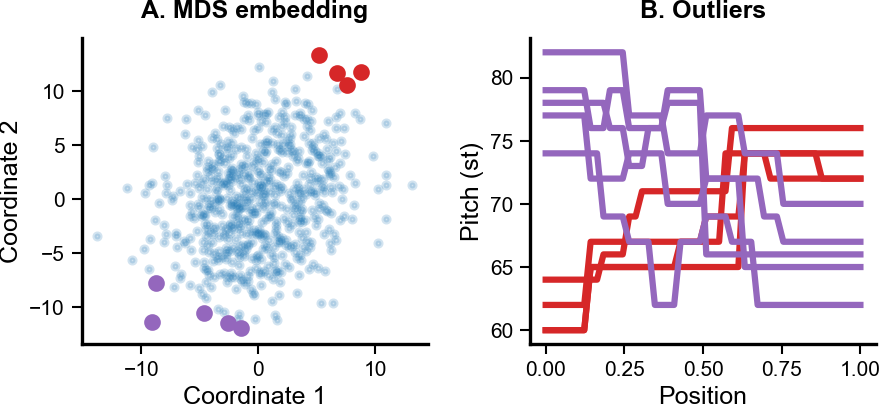

In [198]:
plot_pca_outliers(X_centered_skip_7_eucl_mds)

#### Skip 15

In [202]:
centered_countours_skip_15 = centered_contours[:, np.arange(0, 50, 16)]
centered_skip_15_eucl_dm = distance_matrix(centered_countours_skip_15, centered_countours_skip_15)
X_centered_skip_15_eucl_mds = mds.fit_transform(centered_skip_15_eucl_dm)
X_centered_skip_15_eucl_tsnes = get_tsnes(centered_skip_15_eucl_dm)

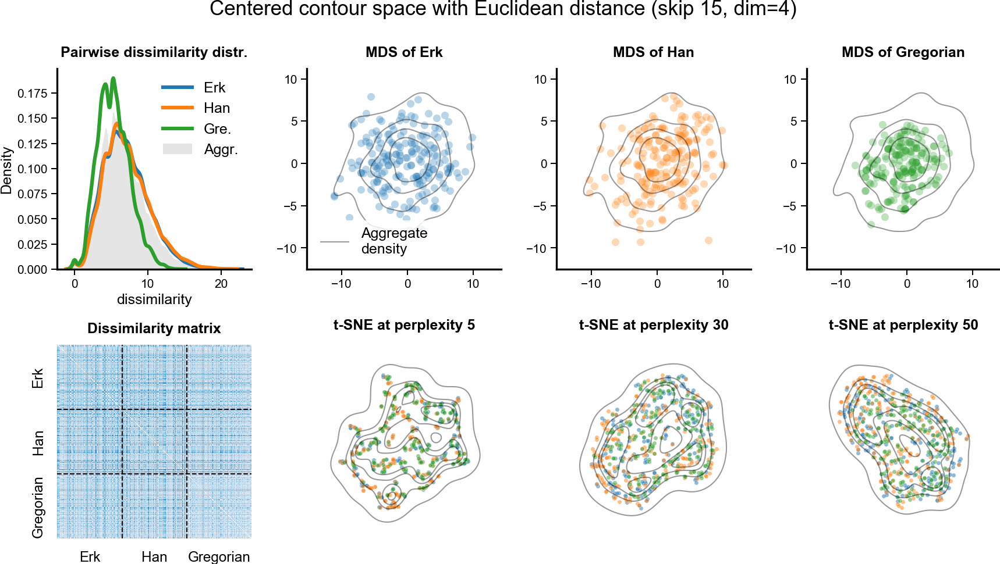

In [203]:
show_space(X_centered_skip_15_eucl_mds, X_centered_skip_15_eucl_tsnes, centered_skip_15_eucl_dm)
plt.suptitle(f'Centered contour space with Euclidean distance (skip 15, dim={centered_countours_skip_15.shape[1]})', y=1.05);

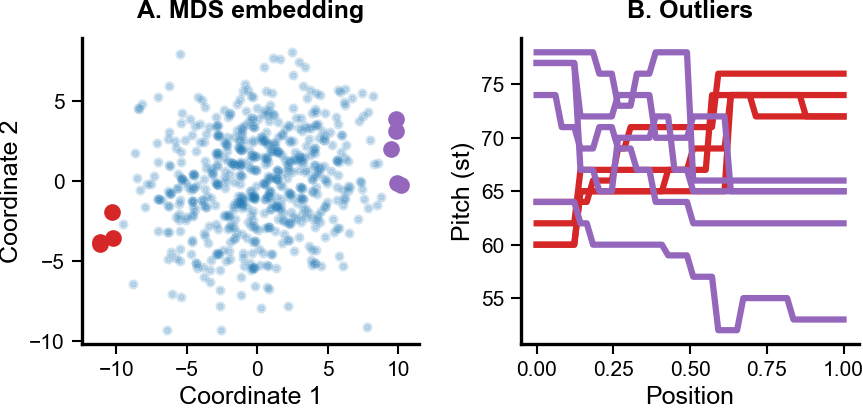

In [204]:
plot_pca_outliers(X_centered_skip_15_eucl_mds)

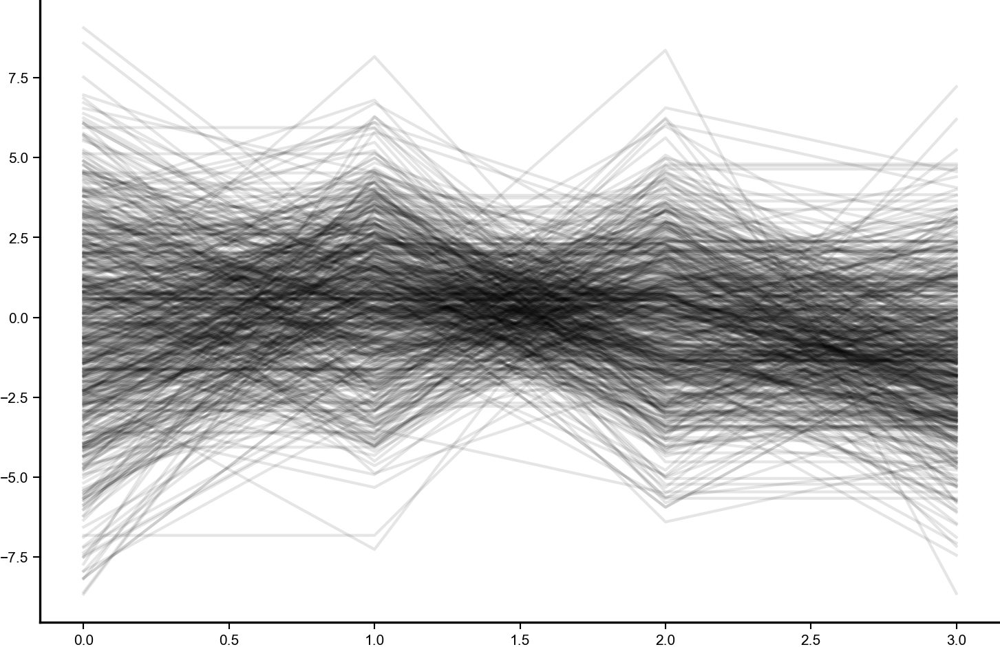

In [215]:
plt.plot(centered_countours_skip_15.T, alpha=.1, lw=1, c='k');

## Clustering

- No evidence for multimodality: to cluster or not to cluster?
- $k$-means on time series vs $k$-means

### Clustering: Euclidian vs DTW

![](https://tslearn.readthedocs.io/en/stable/_images/sphx_glr_plot_kmeans_001.svg)

### Barycenters

![](https://tslearn.readthedocs.io/en/stable/_images/sphx_glr_plot_barycenters_001.svg)

## Smoothing

In [304]:
from scipy.interpolate import interp1d

In [303]:
def smooth(x,window_len=11,window='hanning'):
    #https://scipy.github.io/old-wiki/pages/Cookbook/SignalSmooth.html
    if window_len<3:
        return x
    s = np.r_[x[window_len-1:0:-1], x, x[-2:-window_len-1:-1]]
    w = np.hamming(window_len)
    y = np.convolve(w/w.sum(), s, mode='valid')
    
    if window_len % 2 == 0:
        return y[int(window_len/2-1):-int(window_len/2)]
    else: 
        return y[int(window_len/2):-int(window_len/2)]

# x = np.array([1, 2, 3, 4, 5, 6, 5, 4, 3, 2, 1])
# plt.plot(smooth(x, window_len=7))
# plt.plot(x)

In [297]:
def smooth_interpolation(N, ys, window_len=11, kind='cubic'):
    smooth_ys = smooth(ys, window_len=window_len)
    f = interp1d(np.linspace(0, 1, len(smooth_ys)), smooth_ys, kind=kind)
    return f(np.linspace(0, 1, N))

In [308]:
smoothed_contours_5 = np.array([smooth_interpolation(5, c) for c in centered_contours])
smoothed_contours_10 = np.array([smooth_interpolation(10, c) for c in centered_contours])

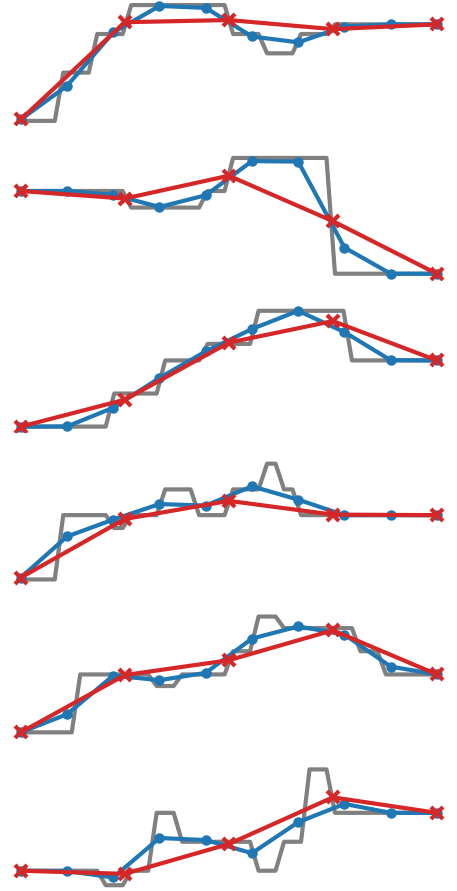

In [337]:
num_examples = 6
plt.figure(figsize=cm2inch(5, 10))
for i in range(num_examples):
    plt.subplot(int(f'{num_examples}1{i+1}'))
    plt.plot(np.linspace(0, 1, 50), centered_contours[i, :], color='.5', ls='-', lw=1)
    plt.plot(np.linspace(0, 1, 10), smoothed_contours_10[i, :], c='C0', marker='.', lw=1)
    plt.plot(np.linspace(0, 1, 5), smoothed_contours_5[i, :], c='C3', marker='x', lw=1)
    plt.axis('off')

In [306]:
smooth_10_eucl_dm = distance_matrix(smoothed_contours_10, smoothed_contours_10)
X_smooth_10_eucl_mds = mds.fit_transform(smooth_10_eucl_dm)
X_smooth_10_eucl_tsnes = get_tsnes(smooth_10_eucl_dm)

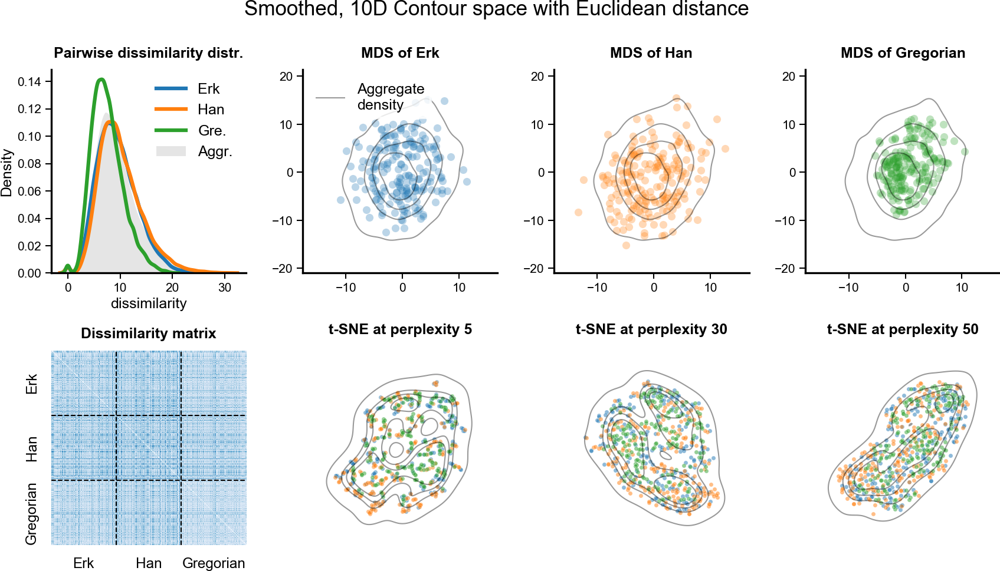

In [307]:
show_space(X_smooth_10_eucl_mds, X_smooth_10_eucl_tsnes, smooth_10_eucl_dm)
plt.suptitle('Smoothed, 10D Contour space with Euclidean distance', y=1.05);

In [310]:
smooth_10_dtw_dm = cdist_dtw(smoothed_contours_10)
X_smooth_10_dtw_mds = mds.fit_transform(smooth_10_dtw_dm)
X_smooth_10_dtw_tsnes = get_tsnes(smooth_10_dtw_dm)

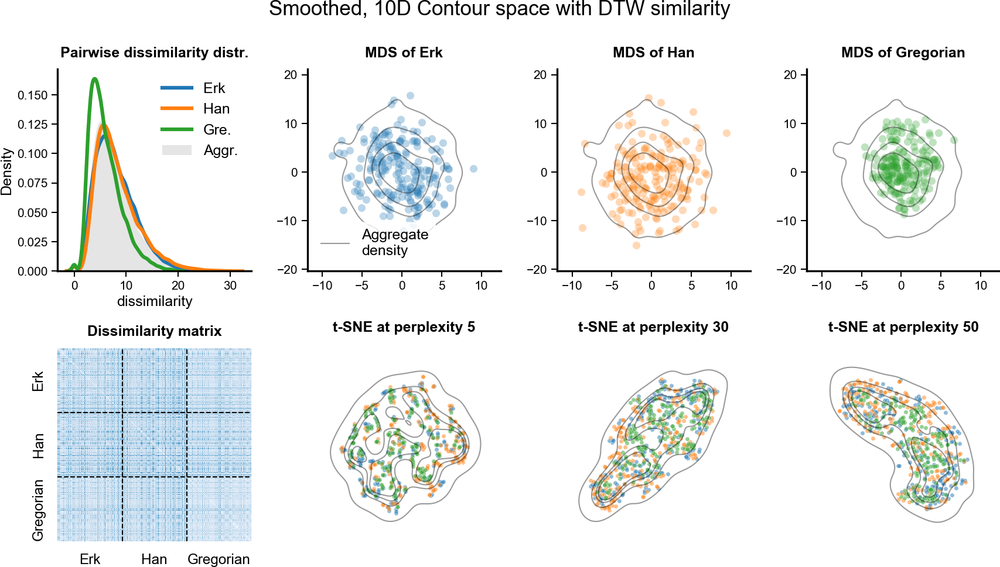

In [311]:
show_space(X_smooth_10_dtw_mds, X_smooth_10_dtw_tsnes, smooth_10_dtw_dm)
plt.suptitle('Smoothed, 10D Contour space with DTW similarity', y=1.05);

In [37]:
## Lenght analysis